In [2]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt
%matplotlib inline
#plt.style.use('seaborn-darkgrid')

In [3]:
crimes = pd.read_csv('DC_16_24.csv')

In [4]:
# Drop the unnecessary date columns
columns_to_drop = ["CENSUS_TRACT","OCTO_RECORD_ID","ANC","END_DATE", "START_DATE","sector","ANC",
                   "offense-text","ucr-rank","PSA","BLOCK_GROUP"]
crimes = crimes.drop(columns=columns_to_drop)

In [5]:
#Rename Columns
column_mapping = {
    "NEIGHBORHOOD_CLUSTER": "Neighborhood",
    "offensegroup": "Offense_Group",
    "LONGITUDE": "Longitude",
    "DISTRICT": "District",
    "SHIFT": "Shift",
    "YBLOCK": "Y_Block",
    "WARD": "Ward",
    "YEAR": "Year",
    "offensekey": "Offense_Key",
    "BID": "BID",
    "UCR_RANK": "UCR_Rank",
    "PSA": "PSA",
    "BLOCK_GROUP": "Block_Group",
    "VOTING_PRECINCT": "Voting_Precinct",
    "XBLOCK": "X_Block",
    "BLOCK": "Block",
    "START_DATE": "Start_Date",
    "CCN": "CCN",
    "METHOD": "Method",
    "LOCATION": "Location",
    "OFFENSE": "Offense",
    "LATITUDE": "Latitude",
    "REPORT_DAT": "Report_Date"
}
crimes = crimes.rename(columns=column_mapping)

In [6]:
# Reorder the columns
new = ["CCN","Year","Report_Date","Shift","Offense_Group","Offense","Offense_Key","Method","Neighborhood","District",
       "Ward","Voting_Precinct","X_Block","Y_Block","Block","BID", "Longitude","Latitude","location"]
crimes = crimes[new]

print(crimes.head())

        CCN  Year             Report_Date     Shift Offense_Group  \
0  17010769  2017   1/20/2017, 4:22:54 AM  midnight       violent   
1  17032983  2017   2/26/2017, 9:42:25 PM   evening       violent   
2  17027599  2017  2/17/2017, 10:39:28 PM   evening       violent   
3  17037599  2017    3/6/2017, 9:28:54 PM   evening       violent   
4  17005184  2017  1/10/2017, 12:40:11 PM       day       violent   

                      Offense                         Offense_Key  Method  \
0                     robbery                     violent|robbery  others   
1  assault w/dangerous weapon  violent|assault w/dangerous weapon  others   
2                     robbery                     violent|robbery  others   
3                     robbery                     violent|robbery     gun   
4                     robbery                     violent|robbery  others   

  Neighborhood  District  Ward Voting_Precinct   X_Block   Y_Block  \
0   cluster 28       7.0   8.0    precinct 114  4012

In [7]:
#Date Stuff

# convert dates to pandas datetime format
crimes.Report_Date = pd.to_datetime(crimes.Report_Date)
# setting the index to be the date will help us a lot later on
#crimes.set_index('Report_Date', inplace=True)

# Set 'Report_Date' column as the index
crimes.set_index('Report_Date', inplace=True, drop=False)

In [8]:
crimes.head()

,CCN,Year,Report_Date,Shift,Offense_Group,Offense,Offense_Key,Method,Neighborhood,District,Ward,Voting_Precinct,X_Block,Y_Block,Block,BID,Longitude,Latitude,location
Report_Date,,,,,,,,,,,,,,,,,,,
2017-01-20 04:22:54,17010769,2017,2017-01-20 04:22:54,midnight,violent,robbery,violent|robbery,others,cluster 28,7.0,8.0,precinct 114,401280.0,133168.0,1909 - 1999 block of 14th street se,NaN,-76.985251,38.866332,"38.8663320175,-76.9852508743"
2017-02-26 21:42:25,17032983,2017,2017-02-26 21:42:25,evening,violent,assault w/dangerous weapon,violent|assault w/dangerous weapon,others,cluster 38,7.0,8.0,precinct 117,401651.0,131223.0,3223 - 3258 block of stanton road se,NaN,-76.980981,38.848810,"38.8488100141,-76.9809806018"
2017-02-17 22:39:28,17027599,2017,2017-02-17 22:39:28,evening,violent,robbery,violent|robbery,others,cluster 25,1.0,6.0,precinct 82,400463.0,136784.0,800 - 812 block of g street ne,NaN,-76.994663,38.898907,"38.8989071507,-76.9946625285"
2017-03-06 21:28:54,17037599,2017,2017-03-06 21:28:54,evening,violent,robbery,violent|robbery,gun,cluster 25,5.0,6.0,precinct 81,402024.0,136712.0,700 - 747 block of 19th street ne,NaN,-76.976668,38.898256,"38.8982563406,-76.9766675078"
2017-01-10 12:40:11,17005184,2017,2017-01-10 12:40:11,day,violent,robbery,violent|robbery,others,cluster 31,6.0,7.0,precinct 95,406775.0,136516.0,500 - 599 block of 55th street ne,NaN,-76.921900,38.896467,"38.8964669245,-76.9219003521"


In [9]:
#crimes.shape

crimes.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 255405 entries, 2017-01-20 04:22:54 to 2024-02-11 15:23:22
Data columns (total 19 columns):
 #   Column           Non-Null Count   Dtype         
---  ------           --------------   -----         
 0   CCN              255405 non-null  int64         
 1   Year             255405 non-null  int64         
 2   Report_Date      255405 non-null  datetime64[ns]
 3   Shift            255405 non-null  object        
 4   Offense_Group    255405 non-null  object        
 5   Offense          255405 non-null  object        
 6   Offense_Key      255405 non-null  object        
 7   Method           255405 non-null  object        
 8   Neighborhood     254658 non-null  object        
 9   District         254740 non-null  float64       
 10  Ward             255370 non-null  float64       
 11  Voting_Precinct  255398 non-null  object        
 12  X_Block          255405 non-null  float64       
 13  Y_Block          255405 non-null  float6

In [10]:
# Convert 'District' and 'Ward' columns to object data type
crimes['District'] = crimes['District'].astype(str)
crimes['Ward'] = crimes['Ward'].astype(str)

# Display the modified DataFrame
crimes.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 255405 entries, 2017-01-20 04:22:54 to 2024-02-11 15:23:22
Data columns (total 19 columns):
 #   Column           Non-Null Count   Dtype         
---  ------           --------------   -----         
 0   CCN              255405 non-null  int64         
 1   Year             255405 non-null  int64         
 2   Report_Date      255405 non-null  datetime64[ns]
 3   Shift            255405 non-null  object        
 4   Offense_Group    255405 non-null  object        
 5   Offense          255405 non-null  object        
 6   Offense_Key      255405 non-null  object        
 7   Method           255405 non-null  object        
 8   Neighborhood     254658 non-null  object        
 9   District         255405 non-null  object        
 10  Ward             255405 non-null  object        
 11  Voting_Precinct  255398 non-null  object        
 12  X_Block          255405 non-null  float64       
 13  Y_Block          255405 non-null  float6

### Exploration & Visualization

In [11]:
# Extract year, month, day, and hour from the datetime values
crimes['Year'] = crimes['Report_Date'].dt.year
crimes['Month'] = crimes['Report_Date'].dt.month
crimes['Day'] = crimes['Report_Date'].dt.day
crimes['Hour'] = crimes['Report_Date'].dt.hour
crimes['Day_of_Week'] = crimes['Report_Date'].dt.dayofweek  # Monday=0, Sunday=6


# Dictionary mapping numerical values to day names
day_mapping = {0: 'Monday', 1: 'Tuesday', 2: 'Wednesday', 3: 'Thursday', 4: 'Friday', 5: 'Saturday', 6: 'Sunday'}

# Replace numerical values with day names in the 'Day_of_Week' column
crimes['Day_of_Week'] = crimes['Day_of_Week'].map(day_mapping)

# Now 'Day_of_Week' column contains day names instead of numerical values
print(crimes.head())

                          CCN  Year         Report_Date     Shift  \
Report_Date                                                         
2017-01-20 04:22:54  17010769  2017 2017-01-20 04:22:54  midnight   
2017-02-26 21:42:25  17032983  2017 2017-02-26 21:42:25   evening   
2017-02-17 22:39:28  17027599  2017 2017-02-17 22:39:28   evening   
2017-03-06 21:28:54  17037599  2017 2017-03-06 21:28:54   evening   
2017-01-10 12:40:11  17005184  2017 2017-01-10 12:40:11       day   

                    Offense_Group                     Offense  \
Report_Date                                                     
2017-01-20 04:22:54       violent                     robbery   
2017-02-26 21:42:25       violent  assault w/dangerous weapon   
2017-02-17 22:39:28       violent                     robbery   
2017-03-06 21:28:54       violent                     robbery   
2017-01-10 12:40:11       violent                     robbery   

                                            Offense_Key  Met

In [12]:
crimes.District.unique()

array(['7.0', '1.0', '5.0', '6.0', '4.0', '2.0', '3.0', 'nan'],
      dtype=object)

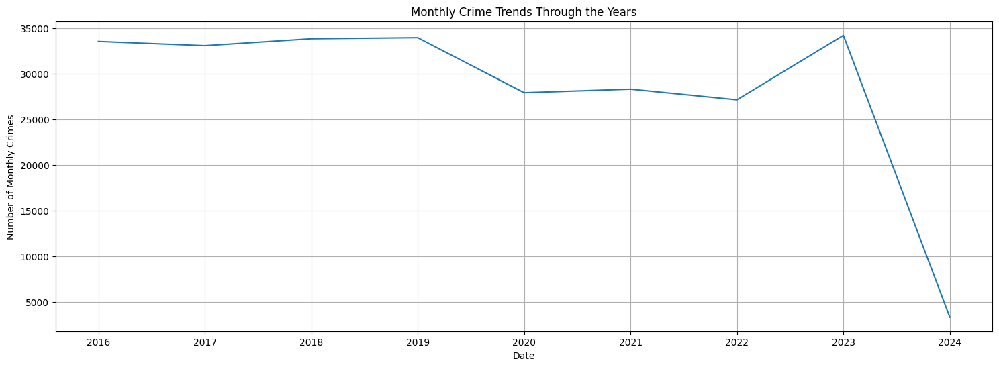

<Figure size 640x480 with 0 Axes>

In [29]:
import matplotlib.pyplot as plt

# Filter out data for the year 2024
crimes_excluding_2024 = crimes[crimes['Year'] != 2024]

# Plot monthly crime trends through the years
plt.figure(figsize=(18, 6))
crimes.groupby(['Year']).size().plot()
plt.title('Monthly Crime Trends Through the Years')
plt.xlabel('Date')
plt.ylabel('Number of Monthly Crimes')
plt.grid(True)
plt.show()


#save
plt.savefig('Monthly.png', format='png', dpi=3000)

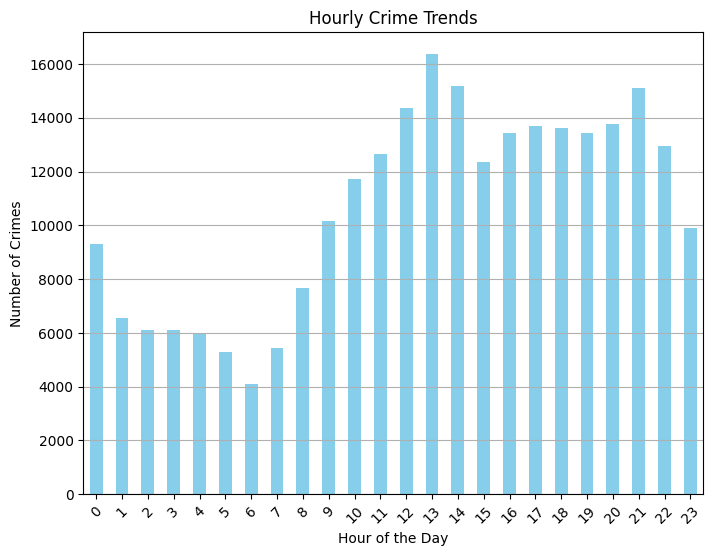

In [15]:
# Plot hourly crime trends
plt.figure(figsize=(8, 6))
crimes.groupby('Hour').size().plot(kind='bar', color='skyblue')
plt.title('Hourly Crime Trends')
plt.xlabel('Hour of the Day')
plt.ylabel('Number of Crimes')
plt.grid(axis='y')
plt.xticks(rotation=45)



plt.savefig('Hourly1.jpg', format='jpeg', dpi=100)

# Display the plot
plt.show()


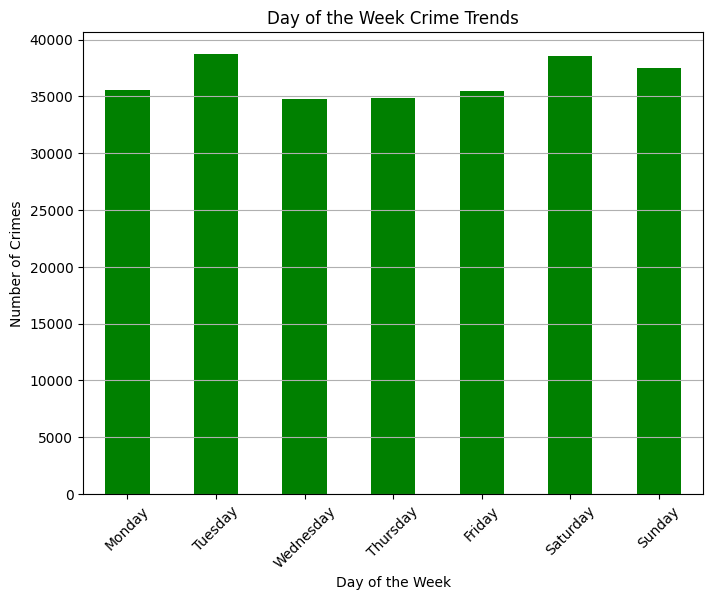

In [16]:
# Plot day of the week trends
day_names = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
plt.figure(figsize=(8, 6))
crimes.groupby('Day_of_Week').size().plot(kind='bar', color='green')
plt.title('Day of the Week Crime Trends')
plt.xlabel('Day of the Week')
plt.ylabel('Number of Crimes')
plt.xticks(range(7), day_names, rotation=45)
plt.grid(axis='y')


plt.savefig('DayOfWeek.jpg', format='jpeg', dpi=100)

plt.show()

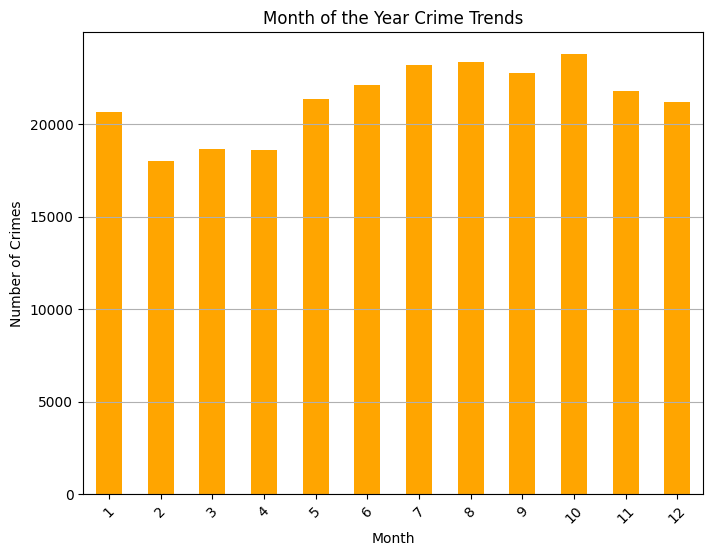

In [17]:
# Plot month of the year trends
plt.figure(figsize=(8, 6))
crimes.groupby('Month').size().plot(kind='bar', color='orange')
plt.title('Month of the Year Crime Trends')
plt.xlabel('Month')
plt.ylabel('Number of Crimes')
plt.grid(axis='y')
plt.xticks(rotation=45)

plt.savefig('mOftY.jpg', format='jpeg', dpi=100)


plt.show()

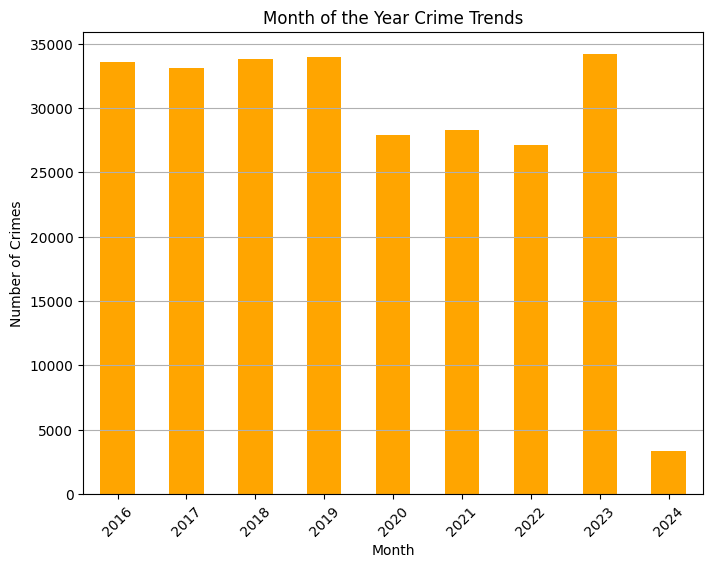

In [18]:
# Plot month of the year trends
plt.figure(figsize=(8, 6))
crimes.groupby('Year').size().plot(kind='bar', color='orange')
plt.title('Month of the Year Crime Trends')
plt.xlabel('Month')
plt.ylabel('Number of Crimes')
plt.grid(axis='y')
plt.xticks(rotation=45)

#plt.savefig('mOftY.jpg', format='jpeg', dpi=100)


plt.show()

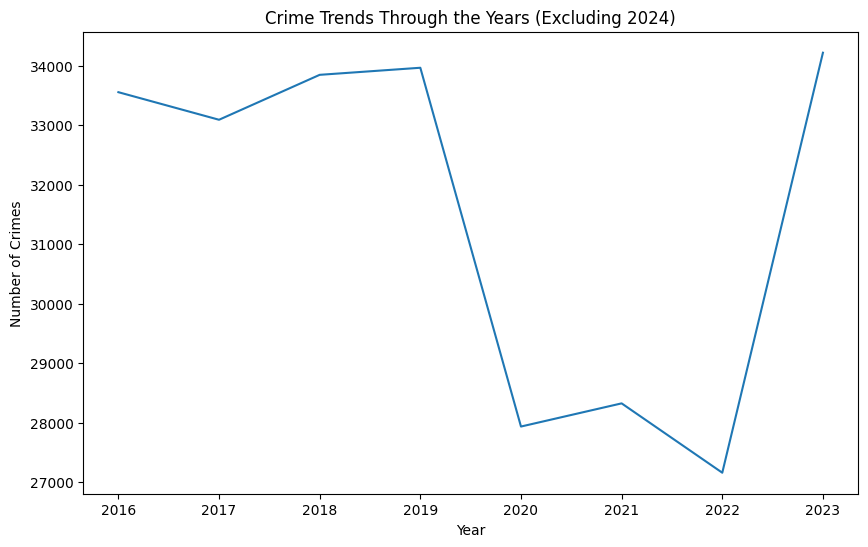

In [32]:
# Filter out data for the year 2024
crimes_excluding_2024 = crimes[crimes['Year'] != 2024]

# Plot monthly crime trends through the years excluding 2024
plt.figure(figsize=(10, 6))
crimes_excluding_2024.groupby(['Year']).size().plot()
plt.title('Crime Trends Through the Years (Excluding 2024)')
plt.xlabel('Year')
plt.ylabel('Number of Crimes')
#plt.grid(True)

# Save the plot
plt.savefig('Yearly.jpg', format='jpeg', dpi=100)

# Display the plot
plt.show()

In [20]:
print(crimes.columns)

Index(['CCN', 'Year', 'Report_Date', 'Shift', 'Offense_Group', 'Offense',
       'Offense_Key', 'Method', 'Neighborhood', 'District', 'Ward',
       'Voting_Precinct', 'X_Block', 'Y_Block', 'Block', 'BID', 'Longitude',
       'Latitude', 'location', 'Month', 'Day', 'Hour', 'Day_of_Week'],
      dtype='object')


In [21]:
crimes['Day_of_Week'].unique()

array(['Friday', 'Sunday', 'Monday', 'Tuesday', 'Saturday', 'Thursday',
       'Wednesday'], dtype=object)

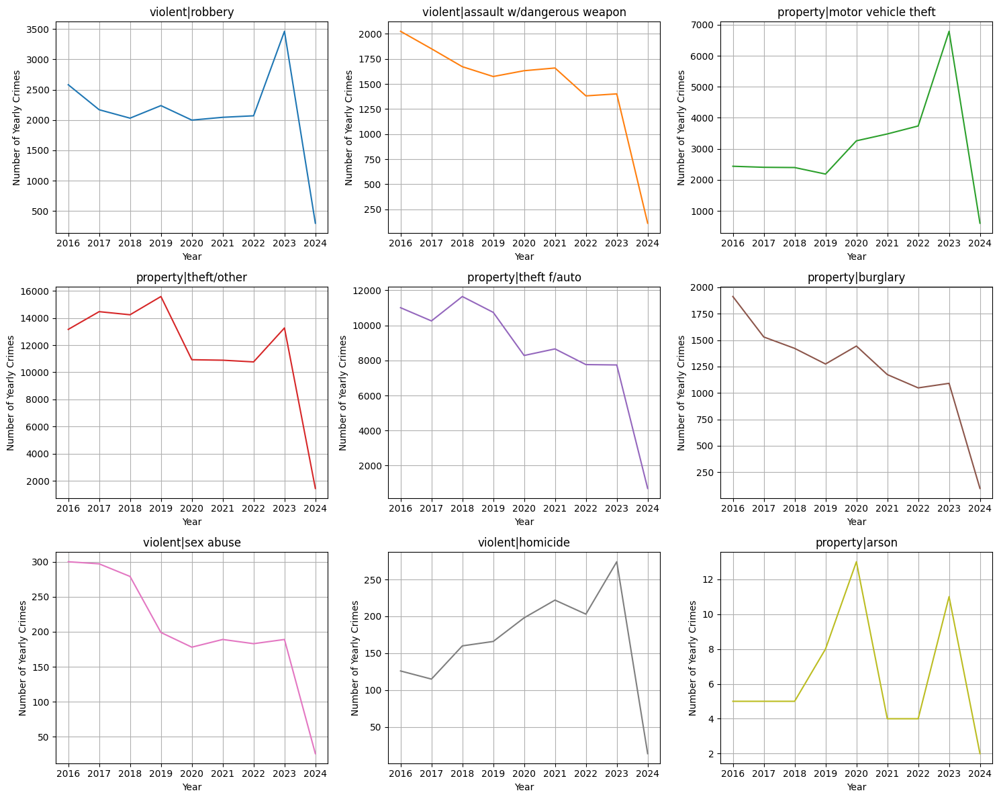

In [22]:
import matplotlib.pyplot as plt
import numpy as np

# Group the data by 'Year', 'Offense_Key', and calculate the size of each group
yearly_crime_counts = crimes.groupby(['Year', 'Offense_Key']).size()

# Get unique offense keys
unique_offense_keys = crimes['Offense_Key'].unique()

# Calculate number of rows and columns for the subplot grid
num_rows = 3
num_cols = 3

# Create a new figure and axis for each category
fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 12))

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Define a colormap
cmap = plt.get_cmap('tab10')

# Iterate over unique offense keys and plot each one in a separate subplot
for i, offense_key in enumerate(unique_offense_keys):
    # Filter data for the current offense key
    offense_data = yearly_crime_counts[:, offense_key]
    
    # Plot yearly crime trends for the current offense key in a separate subplot
    offense_data.plot(ax=axes[i], color=cmap(i))
    axes[i].set_title(offense_key)
    axes[i].set_xlabel('Year')
    axes[i].set_ylabel('Number of Yearly Crimes')
    axes[i].grid(True)

plt.tight_layout()



plt.savefig('grid.jpg', format='jpeg', dpi=100)


plt.show()




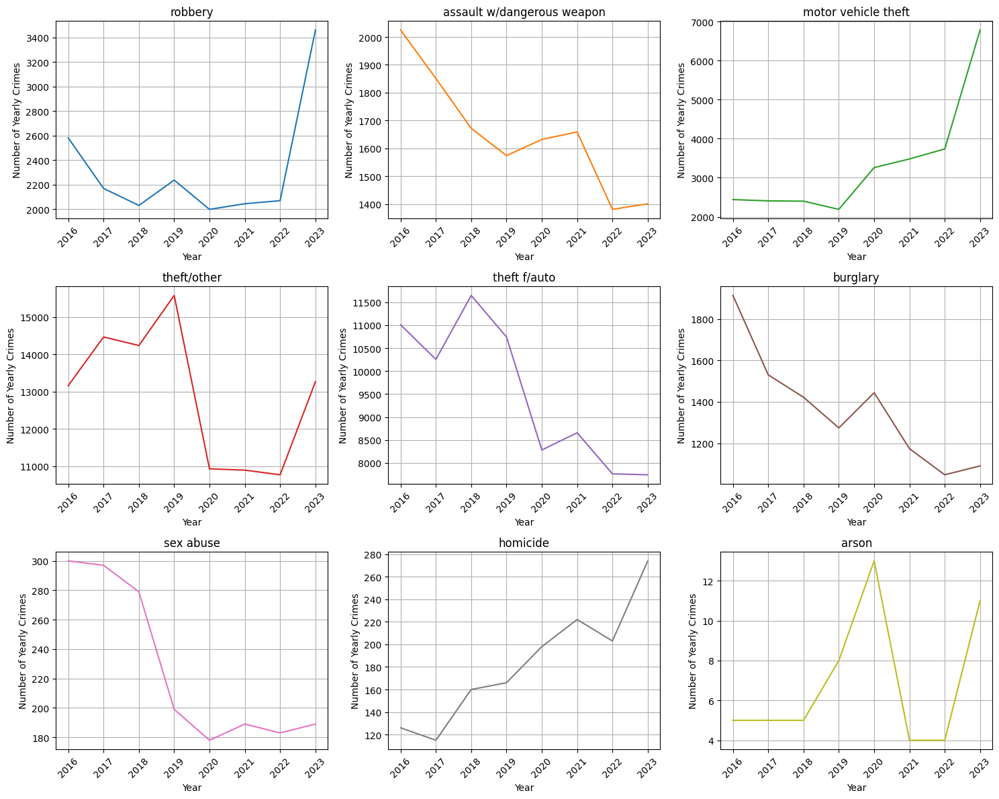

In [26]:
import matplotlib.pyplot as plt
import numpy as np

# Filter out data for the year 2024
crimes_filtered = crimes[crimes['Year'] != 2024]

# Group the data by 'Year' and 'Offense' and calculate the size of each group
yearly_crime_counts = crimes_filtered.groupby(['Year', 'Offense']).size()

# Get unique offense keys
unique_offense_keys = crimes_filtered['Offense'].unique()

# Calculate number of rows and columns for the subplot grid
num_rows = 3
num_cols = 3

# Create a new figure and axes for each category
fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 12))

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Define a colormap
cmap = plt.get_cmap('tab10')

# Iterate over unique offense keys and plot each one in a separate subplot
for i, offense_key in enumerate(unique_offense_keys):
    # Filter data for the current offense key
    offense_data = yearly_crime_counts[:, offense_key]

    # Plot yearly crime trends for the current offense key in a separate subplot
    offense_data.plot(ax=axes[i], color=cmap(i))
    axes[i].set_title(offense_key)
    axes[i].set_xlabel('Year')
    axes[i].set_ylabel('Number of Yearly Crimes')
    
    # Ensure the x-axis labels are visible
    axes[i].tick_params(axis='x', rotation=45)
    
    # Enable grid
    axes[i].grid(True)

# Adjust layout for proper spacing between subplots
plt.tight_layout()

# Save the plot as a JPEG image (optional)
plt.savefig('grid-offense-no24.jpg', format='jpeg', dpi=100)

# Display the plot
plt.show()


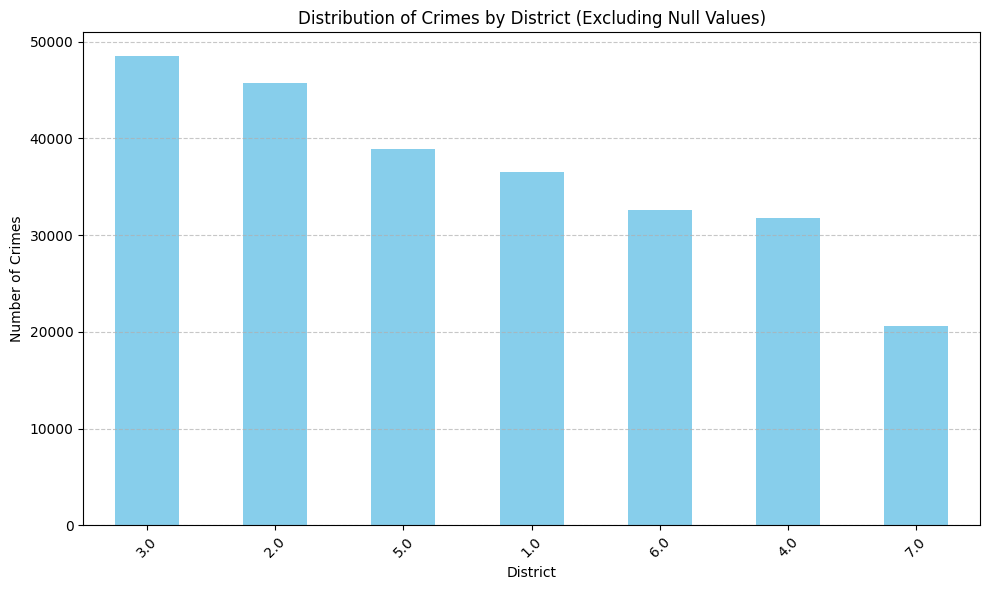

In [21]:


# Filter out rows where 'District' is 'nan'
crimes = crimes[crimes['District'] != 'nan']

# Group the data by District and count the number of crimes in each district
district_crime_counts = crimes['District'].value_counts()

# Plotting the distribution of crimes by district
plt.figure(figsize=(10, 6))
district_crime_counts.plot(kind='bar', color='skyblue')
plt.title('Distribution of Crimes by District (Excluding Null Values)')
plt.xlabel('District')
plt.ylabel('Number of Crimes')
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()


plt.savefig('district.jpg', format='jpeg', dpi=100)

plt.show()


## Spatial Analysis

##### Missing Values

In [22]:
# Check for missing values in latitude and longitude columns
missing_values = crimes[['Latitude', 'Longitude']].isnull().sum()
print("Missing Values:")
print(missing_values)




Missing Values:
Latitude     0
Longitude    0
dtype: int64


##### Outliers?

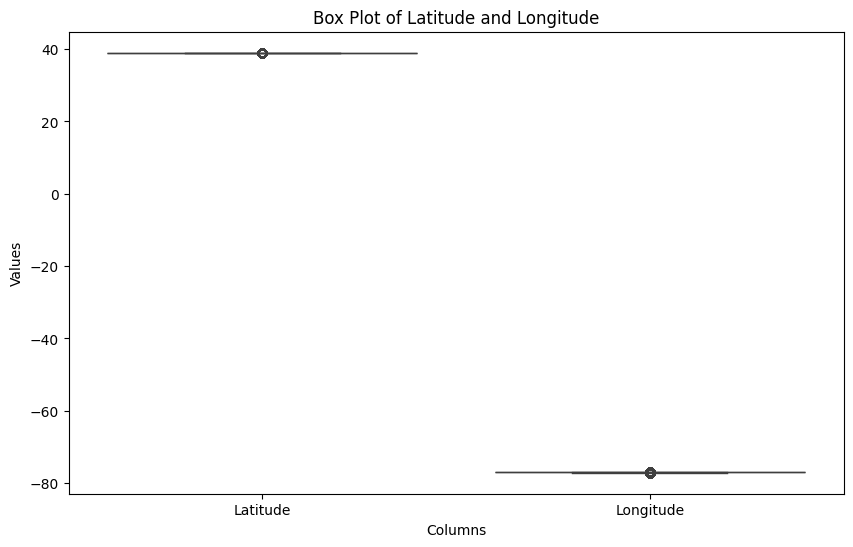

In [23]:
import seaborn as sns
import matplotlib.pyplot as plt

# Create box plots for latitude and longitude columns
plt.figure(figsize=(10, 6))
sns.boxplot(data=crimes[['Latitude', 'Longitude']])
plt.title('Box Plot of Latitude and Longitude')
plt.xlabel('Columns')
plt.ylabel('Values')
plt.show()


##### Check the Coordinate System - Use a standard!

In [24]:
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point


# Convert latitude and longitude columns to a GeoDataFrame
geometry = [Point(xy) for xy in zip(crimes['Longitude'], crimes['Latitude'])]
gdf = gpd.GeoDataFrame(crimes, crs='EPSG:4326', geometry=geometry)

# Check the coordinate system
print("Original coordinate system:", gdf.crs)

# Convert to a common reference system (if needed)
target_crs = 'EPSG:4326'  # Common reference system (WGS84)
gdf = gdf.to_crs(target_crs)

# Verify the new coordinate system
print("Updated coordinate system:", gdf.crs)

# Check for null values and extreme values
print("Null values:\n", gdf.isnull().sum())
print("Extreme values:\n", gdf.describe())

# Perform any necessary data cleaning or preprocessing
# (e.g., removing null values, handling extreme values)

# Save the cleaned data if needed
# gdf.to_file('cleaned_data.shp')


Original coordinate system: EPSG:4326
Updated coordinate system: EPSG:4326
Null values:
 CCN                     0
Year                    0
Report_Date             0
Shift                   0
Offense_Group           0
Offense                 0
Offense_Key             0
Method                  0
Neighborhood          746
District                0
Ward                    0
Voting_Precinct         6
X_Block                 0
Y_Block                 0
Block                   0
BID                207687
Longitude               0
Latitude                0
location                0
Month                   0
Day                     0
Hour                    0
Day_of_Week             0
geometry                0
dtype: int64
Extreme values:
                 CCN           Year        X_Block        Y_Block  \
count  2.547400e+05  254740.000000  254740.000000  254740.000000   
mean   1.958062e+07    2019.459280  399275.510307  137739.941891   
std    2.386170e+06       2.363733    3079.738898    

#### Aggregate Spatially using the Districts

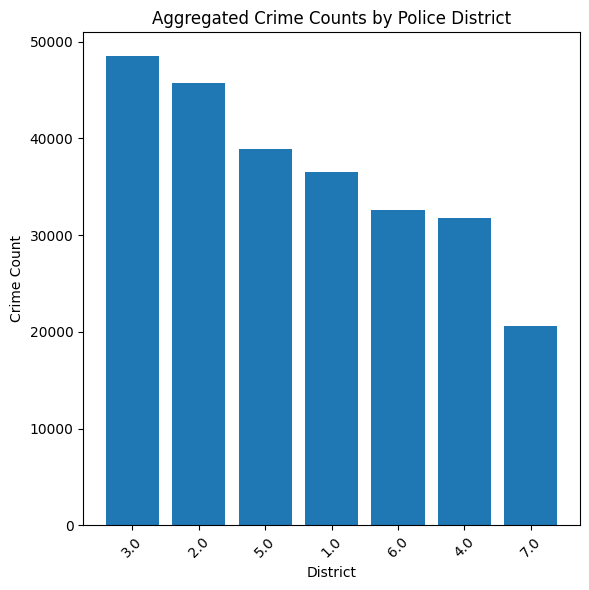

In [101]:
import matplotlib.pyplot as plt

# Assuming 'aggregated_data' DataFrame contains aggregated crime counts by districts
# Perform spatial aggregation based on districts
aggregated_data = gdf.groupby('District').size().reset_index(name='crime_count')


# Sort the aggregated data by crime count (optional)
aggregated_data = aggregated_data.sort_values(by='crime_count', ascending=False)

# Plot the aggregated crime counts as a bar plot
plt.figure(figsize=(6, 6))
plt.bar(aggregated_data['District'], aggregated_data['crime_count'])
plt.xlabel('District')
plt.ylabel('Crime Count')
plt.title('Aggregated Crime Counts by Police District')
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
plt.tight_layout()


plt.savefig('district2.jpg', format='jpeg', dpi=100)

plt.show()


##### DBSCAN - run elsewhwere

### Visualize Clusters

## Incorporating Crime Density

In [29]:
district_crime_counts = crimes.groupby('District').size()
print(district_crime_counts)


District
1.0    36492
2.0    45730
3.0    48549
4.0    31794
5.0    38921
6.0    32615
7.0    20639
dtype: int64


Police Districts - split up into 7 in DC. But data does not exist on the population and physical sizes of these districts. For the sake of this analysis, I will be assuming equal areas for all the police districts.

In [30]:
normalized_district_crime_counts = district_crime_counts / district_crime_counts.sum()
print(normalized_district_crime_counts)


District
1.0    0.143252
2.0    0.179516
3.0    0.190583
4.0    0.124810
5.0    0.152787
6.0    0.128033
7.0    0.081020
dtype: float64


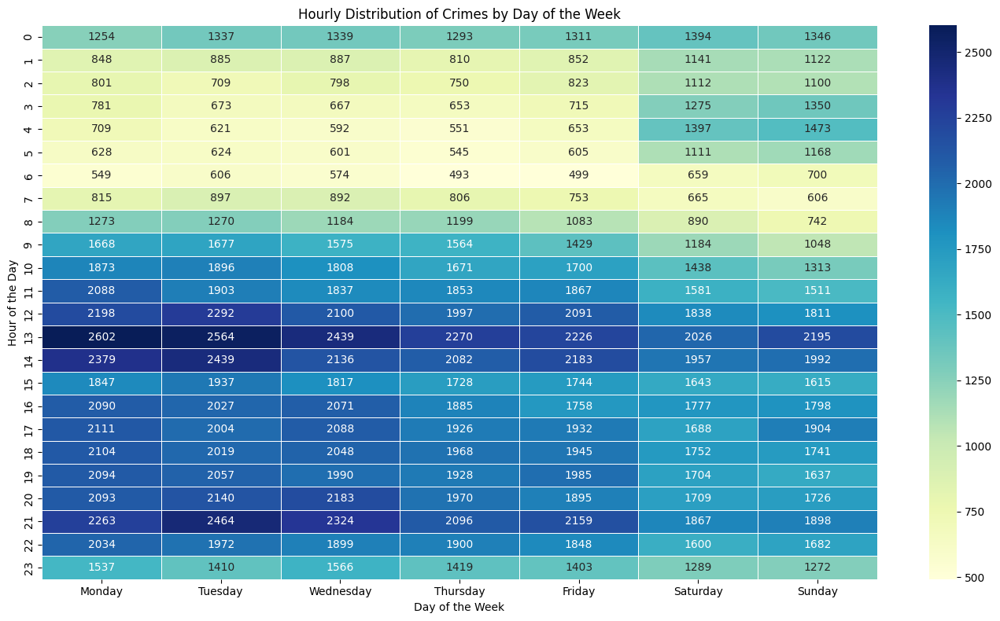

In [34]:
import seaborn as sns

# Create a pivot table to get the count of crimes for each hour and day of the week
hourly_crime_counts = crimes.pivot_table(index='Hour', columns='Day_of_Week', aggfunc='size', fill_value=0)

# Set the order of days for better visualization
day_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
hourly_crime_counts = hourly_crime_counts[day_order]

# Plotting the heatmap
plt.figure(figsize=(14, 8))
sns.heatmap(hourly_crime_counts, cmap='YlGnBu', annot=True, fmt='d', linewidths=.5)
plt.title('Hourly Distribution of Crimes by Day of the Week')
plt.xlabel('Day of the Week')
plt.ylabel('Hour of the Day')
plt.tight_layout()
plt.show()



In [35]:
crimes.columns

Index(['CCN', 'Year', 'Report_Date', 'Shift', 'Offense_Group', 'Offense',
       'Offense_Key', 'Method', 'Neighborhood', 'District', 'Ward',
       'Voting_Precinct', 'X_Block', 'Y_Block', 'Block', 'BID', 'Longitude',
       'Latitude', 'location', 'Month', 'Day', 'Hour', 'Day_of_Week'],
      dtype='object')

In [36]:
# Calculate centroid (average latitude and longitude)
centroid_latitude = crimes['Latitude'].mean()
centroid_longitude = crimes['Longitude'].mean()

print("Centroid Latitude:", centroid_latitude)
print("Centroid Longitude:", centroid_longitude)

Centroid Latitude: 38.90751295931232
Centroid Longitude: -77.0083595148745


### Some Maps?

In [37]:
import geopandas as gpd
import math
import folium
from folium import Choropleth, Circle, Marker
from folium.plugins import HeatMap, MarkerCluster

In [108]:
m_1 = folium.Map(location=[38.90751295931232,-77.0083595148745], tiles='openstreetmap', zoom_start=11)
m_1

#m_1.save("main-map.jpg")

In [49]:
# m_5 = folium.Map(location=[38.90751295931232,-77.0083595148745], tiles='cartodbpositron', zoom_start=12)
# HeatMap(data=crimes[['Latitude', 'Longitude']], radius=8).add_to(m_5)
# m_5

In [48]:
import folium
from folium.plugins import HeatMap
import pandas as pd

# Define the range of years to visualize
start_year = 2016
end_year = 2024

# Iterate over each year
for year in range(start_year, end_year + 1):
    # Filter the data for the current year
    crimes_year = crimes[crimes['Year'] == year]
    
    # Create a folium map centered around Washington, DC - centrium
    m = folium.Map(location=[38.90751295931232, -77.0083595148745], tiles='cartodbpositron', zoom_start=12)
    
    # Create a heatmap with the filtered data for the current year
    HeatMap(data=crimes_year[['Latitude', 'Longitude']], radius=8).add_to(m)
    
    # Display the map
    print(f"Year: {year}")
    display(m)


Year: 2016


Year: 2017


Year: 2018


Year: 2019


Year: 2020


Year: 2021


Year: 2022


Year: 2023


Year: 2024


In [40]:
# GeoDataFrame with geographical boundaries of Boston police districts
districts_full = gpd.read_file('Police_Districts.shp')
districts = districts_full[["DISTRICT", "geometry"]].set_index("DISTRICT")
districts.head(7)

,geometry
DISTRICT,
4,"POLYGON ((-77.02952 38.98704, -77.02829 38.986..."
2,"POLYGON ((-77.05172 38.98622, -77.05167 38.986..."
5,"POLYGON ((-76.97356 38.94333, -76.97190 38.942..."
3,"POLYGON ((-77.03654 38.93613, -77.03654 38.936..."
6,"POLYGON ((-76.92628 38.90635, -76.92593 38.906..."
1,"POLYGON ((-77.00923 38.90708, -77.00919 38.907..."
7,"POLYGON ((-76.98712 38.86903, -76.98712 38.868..."


In [41]:
# Assuming your DataFrame is named 'crimes'
crimes['District'] = crimes['District'].astype(str).str.replace('.0', '').astype(int)


/var/folders/c2/5fxpw5215nxfm047bjnsl7x40000gn/T/ipykernel_97277/4183332400.py:2: FutureWarning: The default value of regex will change from True to False in a future version.
  crimes['District'] = crimes['District'].astype(str).str.replace('.0', '').astype(int)


In [42]:
district_crime_counts = crimes.groupby('District').size()
print(district_crime_counts)

District
1    36492
2    45730
3    48549
4    31794
5    38921
6    32615
7    20639
dtype: int64


In [43]:
plot_dict = crimes.District.value_counts()
plot_dict.head(7)

3    48549
2    45730
5    38921
1    36492
6    32615
4    31794
7    20639
Name: District, dtype: int64

In [44]:
# # Create the Choropleth map
# m_6 = folium.Map(location=[38.90751295931232, -77.0083595148745], tiles='cartodbpositron', zoom_start=12)
# Choropleth(geo_data=districts.__geo_interface__, data=plot_dict.to_dict(), key_on="feature.id", fill_color='YlGnBu', 
#            legend_name='Major criminal incidents (Feb 2016-Feb 2024)').add_to(m_6)
# m_6


In [45]:
import folium

# Define the years you want to create Choropleth maps for
years = range(2016, 2025)

# Create a Choropleth map for each year
for year in years:
    # Filter the data for the current year
    crimes_year = crimes[crimes['Year'] == year]
    plot_dict = crimes_year['District'].value_counts()
    
    # Create the Choropleth map
    m = folium.Map(location=[38.90751295931232, -77.0083595148745], tiles='cartodbpositron', zoom_start=12)
    Choropleth(geo_data=districts.__geo_interface__, data=plot_dict.to_dict(), key_on="feature.id", fill_color='YlGnBu', 
               legend_name=f'Major criminal incidents ({year})').add_to(m)
    
    # Save or display the map
    # m.save(f'choropleth_{year}.html')  # Save the map to an HTML file
    display(m)  # Display the map in Jupyter Notebook


In [33]:
# # Create a Choropleth map for each year and save it as an HTML file
# for i, year in enumerate(years):
#     # Filter the data for the current year
#     crimes_year = crimes[crimes['Year'] == year]
#     plot_dict = crimes_year['District'].value_counts()
    
#     # Create the Choropleth map
#     m = folium.Map(location=[38.90751295931232, -77.0083595148745], tiles='cartodbpositron', zoom_start=12)
#     Choropleth(geo_data=districts.__geo_interface__, data=plot_dict.to_dict(), key_on="feature.id", fill_color='YlGnBu', 
#                legend_name=f'Major criminal incidents ({year})').add_to(m)
    
#     # Save the map as an HTML file
#     m.save(f'choropleth_{year}.html')

# # Display the saved HTML files side by side
# from IPython.display import display_html
# html_content = ''
# for year in years:
#     html_content += f'<iframe src="choropleth_{year}.html" width="50%" height="500"></iframe>'
# display_html(html_content, raw=True)


In [43]:
#crimes.Report_Date.max()

In [48]:
# from sklearn.cluster import KMeans
# import matplotlib.pyplot as plt

# # Assuming 'X_scaled' contains your normalized data
# # Calculate inertia for different values of k
# def optimise_k_means(X_scaled,max_k):
#     means=[]
#     inertia = []
    
#     for k in range(1, max_k):
#         kmeans = KMeans(n_clusters=k, random_state=42)
#         kmeans.fit(X_scaled)
#         inertia.append(kmeans.inertia_)

# # Plot the elbow curve
#     plt.plot(range(1, 7), inertia, marker='o')
#     plt.xlabel('Number of Clusters (k)')
#     plt.ylabel('Inertia')
#     plt.title('Elbow Method')
#     plt.show()


In [49]:
# optimise_k_means(crimes[['Latitude','Longitude']],7)

# Time Series

In [34]:
# #convert Report_Date back to string
# crimes['Report_Date'] = crimes['Report_Date'].astype(str)

# # Split 'Report_Date' colume into 'DATE' and 'TIME'. 'DATE' will give us the exact date of the crime
# crimes[["DATE","TIME"]]=crimes['Report_Date'].str.split(" ",expand=True)

In [35]:
# # plot line chart
# def lineplt(x,y,xlabel,ylabel,title,size,tick_spacing):
#     fig,ax=plt.subplots(figsize = size)
#     plt.plot(x,y)
#     ax.xaxis.set_major_locator(ticker.MultipleLocator(tick_spacing))
#     plt.xlabel(xlabel,fontsize = 15)
#     plt.ylabel(ylabel,fontsize = 15)
#     plt.title(title,fontsize = 20)
#     plt.show()

# # Create 2 columns DateFrame
# def createdf(c1,d1,c2,d2):
#     dic = {c1:d1,c2:d2}
#     df = pd.DataFrame(dic)
#     return df

# # Plot histogram
# def plthis(d,bin, title):
#     plt.figure(figsize=(10,8))
#     plt.hist(d, bins=bin)
#     plt.title(title, fontsize = 20)
#     plt.show()

Any patterns? - Use new Date column here to track visuals

#### Distributions by Day

In [36]:
# # Put Date and Count into a new Dataframe
# c = createdf("Date",crimes["DATE"].value_counts().index,"Count",crimes["DATE"].value_counts())

# # c is the total number of crimes per day
# c.head(5)

In [42]:
# plthis(c["Count"],50, "Crimes Count Distribution")

In [37]:
# print('skewness is ' + str(c['Count'].skew()))
# print('kurtosis is ' + str(c['Count'].kurt()))

I went with a histogram and separated them into 50 bins so adequately capture the distribution here. It looks like a very normal distribution, with a few outliers here and there. The skewness of 0.19 indicates that there is a very little positive skew here i.e. the right tail of the distribution is slightly more spread out than the left side. The kurtosis value of 0.5 shows a very slight positive kurtosis again, suggesting a very mild movement away from a normal distribution. The data shows more peaks and heavier tails than a normal distribution, but only very slightly. I will run some more statistical tests to ensure this can be treated as a normal distribution.

In [39]:
# bin=pd.cut(c["Count"],50)
# for_test= createdf("Bin",bin.value_counts().index,"Count",bin.value_counts())
# test_sort = for_test.sort_values(by = "Bin", ascending = True)

##### Shapiro-Wilk test

In [40]:
# import scipy

# (_,p) = scipy.stats.shapiro(test_sort["Count"])
# print('p-value is ' + str(p))

##### Kolmogorov-Smirnov test

In [41]:
# (_,p) = scipy.stats.kstest(test_sort["Count"],'norm')
# print('p-value is ' + str(p))

Both of these tests produce very tiny p-values, much smaller than the typical alpha threshold of 5%. 
I can conclude here that the distribution is significantly significant or different from normal distributions 95% of the time (or with 95% confidence).

The dataset here exhibits strong signs of a non-normal distribution. Might need to transform (log), for further analysis.

In [87]:
#Code before I transformed into a log scale

# from sklearn.model_selection import train_test_split

# X = daily_crime_counts.index.values.reshape(-1, 1)  # Use the index (dates) as features
# y = daily_crime_counts['Count'].values  # Target variable (crime counts)

# # Split the data into training and test sets (75-25 split)
# X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, shuffle=False)

# # Display the shape of the resulting sets
# print("Training set shape:", X_train.shape, y_train.shape)
# print("Test set shape:", X_test.shape, y_test.shape)


# Code before transforming to log

# import pandas as pd

# # Convert the NumPy array to a DataFrame
# df_train = pd.DataFrame(X_train, columns=['Count'])

# # Descriptive statistics
# print(df_train.describe())

# # Test for stationarity (Augmented Dickey-Fuller test)
# from statsmodels.tsa.stattools import adfuller

# result = adfuller(df_train['Count'])
# print('ADF Statistic:', result[0])
# print('p-value:', result[1])
# print('Critical Values:')
# for key, value in result[4].items():
#     print(f'   {key}: {value}')

# # from statsmodels.tsa.stattools import adfuller
# # adf_test = adfuller(X_train)
# # print(f'p-value: {adf_test[1]}')



# from statsmodels.tsa.seasonal import seasonal_decompose

# # Decompose the time series
# decomposition = seasonal_decompose(df_train['Count'], model='additive', period=7)  # Assuming weekly seasonality
# trend = decomposition.trend
# seasonal = decomposition.seasonal
# residual = decomposition.resid

# # Plot the decomposition components
# plt.figure(figsize=(8, 6))
# plt.subplot(411)
# plt.plot(df_train['Count'], label='Original')
# plt.legend(loc='best')
# plt.subplot(412)
# plt.plot(trend, label='Trend')
# plt.legend(loc='best')
# plt.subplot(413)
# plt.plot(seasonal, label='Seasonality')
# plt.legend(loc='best')
# plt.subplot(414)
# plt.plot(residual, label='Residuals')
# plt.legend(loc='best')
# plt.tight_layout()
# plt.show()
